In [ ]:
import pandas as pd

data = pd.read_excel(r"D:\Downloads\DSTC vòng 2\cleaned data\UPCOM_cleaned.xlsx")
data = data.drop("Unnamed: 0", axis =1)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30592 entries, 0 to 30591
Data columns (total 22 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ticker           30592 non-null  object 
 1   timestamp        30592 non-null  object 
 2   open             30592 non-null  float64
 3   high             30592 non-null  float64
 4   low              30592 non-null  float64
 5   close            30592 non-null  float64
 6   volume           30592 non-null  int64  
 7   ema_50           30592 non-null  float64
 8   ema_200          30592 non-null  float64
 9   macd             30592 non-null  float64
 10  macd_signal      30592 non-null  float64
 11  macd_diff        30592 non-null  float64
 12  rsi              30592 non-null  float64
 13  bollinger_hband  30592 non-null  float64
 14  bollinger_lband  30592 non-null  float64
 15  mfi              30592 non-null  float64
 16  golden_cross     30592 non-null  int64  
 17  death_cross 

In [2]:
data.describe()

,open,high,low,close,volume,ema_50,ema_200,macd,macd_signal,macd_diff,rsi,bollinger_hband,bollinger_lband,mfi,golden_cross,death_cross,return,macd_cross,bollinger_pct,bollinger_bw
count,30592.000000,30592.000000,30592.000000,30592.000000,3.059200e+04,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000,30592.000000
mean,19606.425243,19886.202696,19299.832450,19573.849945,4.929247e+05,19269.227333,18608.121643,89.529099,88.489845,1.039253,51.149594,20649.365077,18249.024799,51.540764,0.003857,0.003007,0.000989,-0.000360,0.517978,0.137966
std,21905.403718,22154.071951,21632.975402,21886.247841,1.133994e+06,21434.527589,19925.719766,773.204794,735.568233,218.462732,12.928450,23030.664834,20566.806982,17.876216,0.061988,0.054757,0.023463,0.275567,0.336596,0.120018
min,1400.000000,1400.000000,1200.000000,1287.000000,1.000000e+02,1641.059718,1757.847586,-9647.815862,-8576.896189,-5049.515143,4.770083,1630.569378,303.286092,0.000000,0.000000,0.000000,-0.138594,-1.000000,-0.536341,0.008097
25%,7477.470000,7600.000000,7300.000000,7445.689708,4.270000e+04,7470.074516,7591.988956,-99.464312,-96.008363,-40.239359,42.741649,7902.467729,6924.910162,38.584257,0.000000,0.000000,-0.008822,0.000000,0.256770,0.063823
50%,11900.000000,12100.000000,11700.000000,11864.247000,1.357000e+05,11810.946595,11714.356599,11.577086,14.012283,0.848013,50.492589,12584.185256,10971.621247,52.571008,0.000000,0.000000,-0.000502,0.000000,0.509135,0.103415
75%,20144.452500,20617.170000,19700.288427,20121.200261,4.748000e+05,18982.267706,18108.782499,195.812446,190.471531,43.355454,59.516800,21876.640936,18130.903500,64.840902,0.000000,0.000000,0.008284,0.000000,0.767544,0.170019
max,179223.310435,179292.269000,168948.484250,177057.321908,6.871220e+07,152475.399697,133756.828845,11047.584627,9737.953439,5341.905354,96.169134,173644.658136,148728.578383,99.906281,1.000000,1.000000,0.228674,1.000000,1.560371,1.945464


In [3]:
data.isna().sum()

ticker             0
timestamp          0
open               0
high               0
low                0
close              0
volume             0
ema_50             0
ema_200            0
macd               0
macd_signal        0
macd_diff          0
rsi                0
bollinger_hband    0
bollinger_lband    0
mfi                0
golden_cross       0
death_cross        0
return             0
macd_cross         0
bollinger_pct      0
bollinger_bw       0
dtype: int64

In [4]:
data.duplicated().sum()

0

In [5]:
counts = data.groupby('ticker')['timestamp'].count()
outlier = counts[counts != 612]
print(outlier)


ticker
BMS    611
MCH    609
SSH    609
VEA    611
Name: timestamp, dtype: int64


In [6]:
timestamps_per_ticker = data.groupby('ticker')['timestamp'].apply(set)
common_timestamps = set.intersection(*timestamps_per_ticker)
df_cleaned = data[data['timestamp'].isin(common_timestamps)].copy()

In [7]:
counts = df_cleaned.groupby('ticker')['timestamp'].count()
outlier = counts[counts != 604]
print(outlier.size)
# print(counts)

0


In [ ]:
df_cleaned["timestamp"] = pd.to_datetime(df_cleaned["timestamp"])
df_cleaned.info()
df_cleaned.to_excel("cleaned data/UPCOM_cleaned_last.xlsx")

<class 'pandas.core.frame.DataFrame'>
Index: 30200 entries, 0 to 30591
Data columns (total 22 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   ticker           30200 non-null  object        
 1   timestamp        30200 non-null  datetime64[ns]
 2   open             30200 non-null  float64       
 3   high             30200 non-null  float64       
 4   low              30200 non-null  float64       
 5   close            30200 non-null  float64       
 6   volume           30200 non-null  int64         
 7   ema_50           30200 non-null  float64       
 8   ema_200          30200 non-null  float64       
 9   macd             30200 non-null  float64       
 10  macd_signal      30200 non-null  float64       
 11  macd_diff        30200 non-null  float64       
 12  rsi              30200 non-null  float64       
 13  bollinger_hband  30200 non-null  float64       
 14  bollinger_lband  30200 non-null  float64   

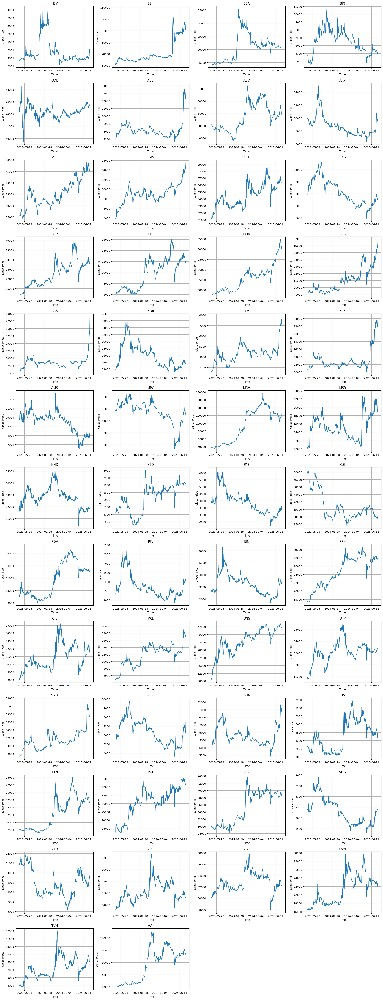

In [9]:
import matplotlib.pyplot as plt
import math
from matplotlib.ticker import MaxNLocator


tickers = df_cleaned['ticker'].unique()
n = len(tickers)
cols = 4 
rows = math.ceil(n / cols)

plt.figure(figsize=(20, 4 * rows)) 

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    ax = plt.subplot(rows, cols, i+1)
    ax.plot(df_temp['timestamp'], df_temp['close'])
    ax.set_title(t)
    ax.set_xlabel('Time')
    ax.xaxis.set_major_locator(MaxNLocator(nbins=4))
    ax.set_ylabel('Close Price')
    ax.grid(True)

plt.tight_layout()  
plt.show()

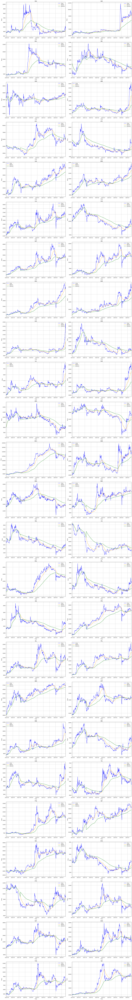

In [10]:
tickers = df_cleaned['ticker'].unique()
n = len(tickers)
cols = 2  
rows = math.ceil(n / cols)

plt.figure(figsize=(20, 6 * rows)) 
for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    
    ax = plt.subplot(rows, cols, i+1)
    ax.plot(df_temp['timestamp'], df_temp['close'], label='Close', color='blue')
    ax.plot(df_temp['timestamp'], df_temp['ema_50'], label='EMA50', color='orange')
    ax.plot(df_temp['timestamp'], df_temp['ema_200'], label='EMA200', color='green')
    
    ax.set_title(t)
    ax.set_xlabel('Time')
    ax.set_ylabel('Price')
    ax.grid(True)
    ax.legend(fontsize=10)
    
 
    ax.set_xlim(df_temp['timestamp'].min(), df_temp['timestamp'].max())

plt.tight_layout()
plt.show()

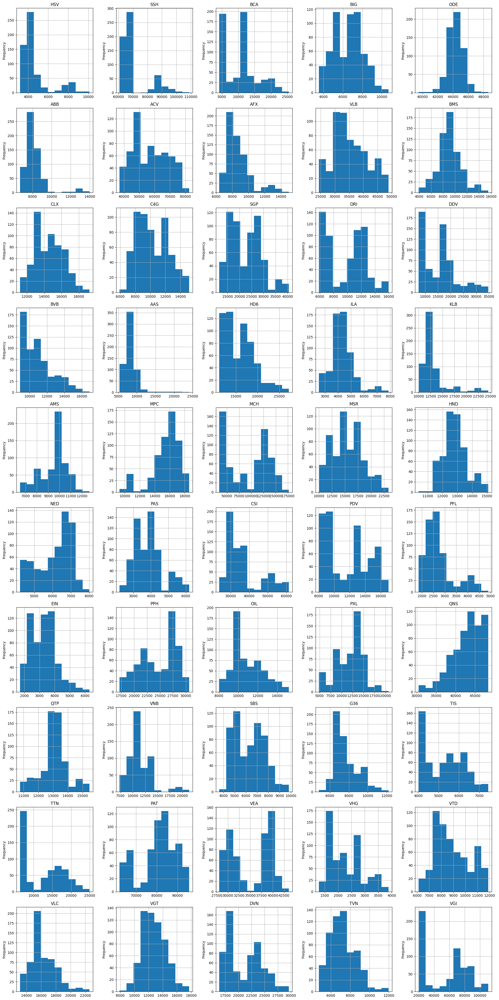

In [11]:
tickers = df_cleaned['ticker'].unique()
n = len(tickers)
cols = 5 
rows = math.ceil(n / cols)

plt.figure(figsize=(20, 4 * rows)) 

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    ax = plt.subplot(rows, cols, i+1)
    ax.hist(df_temp['close'])
    ax.set_title(t)
    ax.set_ylabel("Frequency")
    ax.grid(True)

plt.tight_layout()  
plt.show()

In [12]:
df_cleaned.groupby('ticker')['return'].describe()

,count,mean,std,min,25%,50%,75%,max
ticker,,,,,,,,
AAS,604.0,0.002587,0.027010,-0.109431,-0.010746,-0.000650,0.012071,0.139886
ABB,604.0,0.000971,0.017775,-0.078774,-0.006918,-0.000677,0.005232,0.147288
ACV,604.0,0.000506,0.017566,-0.107328,-0.008916,-0.000757,0.007211,0.147010
AFX,604.0,0.000254,0.020035,-0.073743,-0.009401,-0.001094,0.007232,0.114353
AMS,604.0,-0.000110,0.019359,-0.079906,-0.010963,-0.000867,0.008248,0.126519
BCA,604.0,0.002087,0.041324,-0.127963,-0.015825,-0.001724,0.013081,0.150938
BIG,604.0,0.000750,0.033916,-0.124672,-0.015654,-0.001694,0.013000,0.138181
BMS,604.0,0.002482,0.026100,-0.105456,-0.010818,0.001132,0.014763,0.146117
BVB,604.0,0.001126,0.017452,-0.095191,-0.007060,-0.000369,0.006499,0.137218


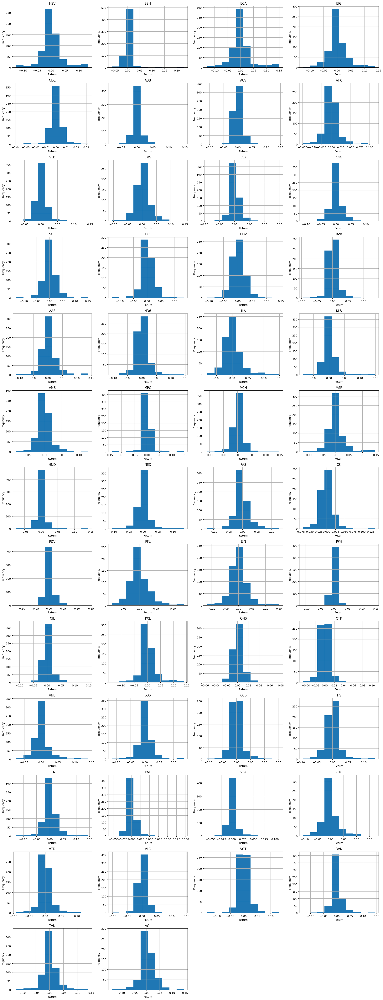

In [13]:
tickers = df_cleaned['ticker'].unique()
cols = 4  
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows)) 

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    ax = plt.subplot(rows, cols, i+1)
    ax.hist(df_temp['return'])
    ax.set_title(t)
    ax.set_ylabel("Frequency")
    ax.set_xlabel('Return')
    ax.grid(True)

plt.tight_layout()  
plt.show()

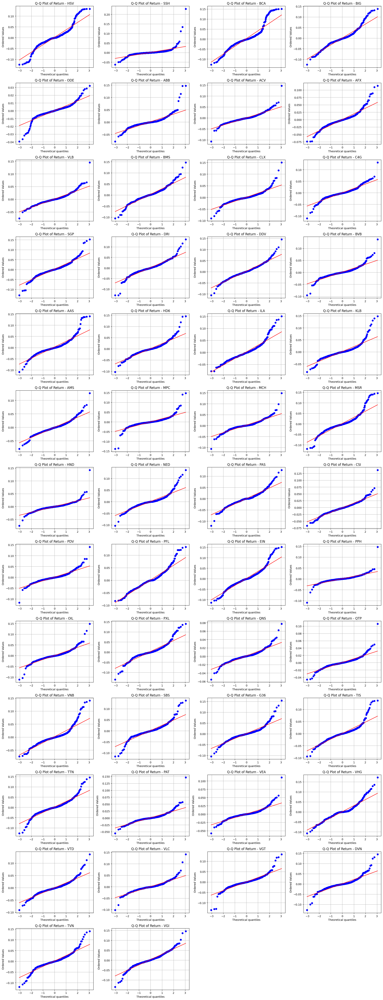

In [14]:
import scipy.stats as stats

tickers = df_cleaned['ticker'].unique()
cols = 4  
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows)) 

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    ax = plt.subplot(rows, cols, i+1)
    stats.probplot(df_temp['return'].dropna(), dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of Return - {t}')
    plt.grid(True)

plt.tight_layout()  
plt.show()

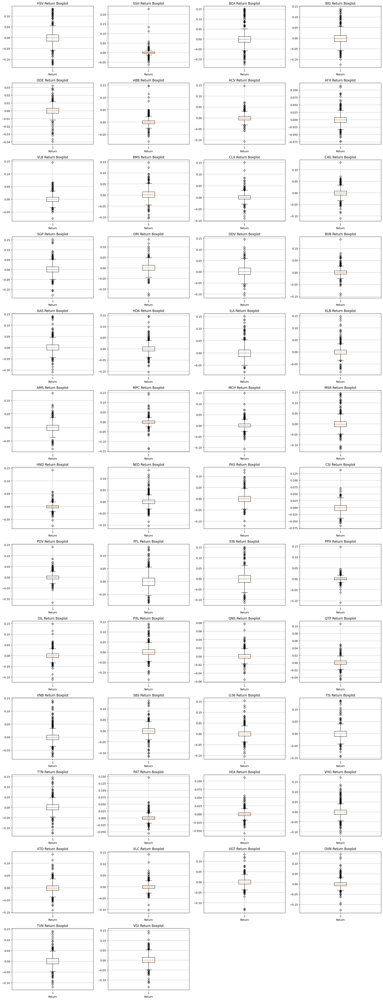

In [15]:
import scipy.stats as stats

tickers = df_cleaned['ticker'].unique()
cols = 4  
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows)) 

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    ax = plt.subplot(rows, cols, i+1)
    ax.boxplot(df_temp['return'])
    ax.set_title(f'{t} Return Boxplot')
    ax.set_xlabel('Return')
    ax.grid(True)

plt.tight_layout()  
plt.show()

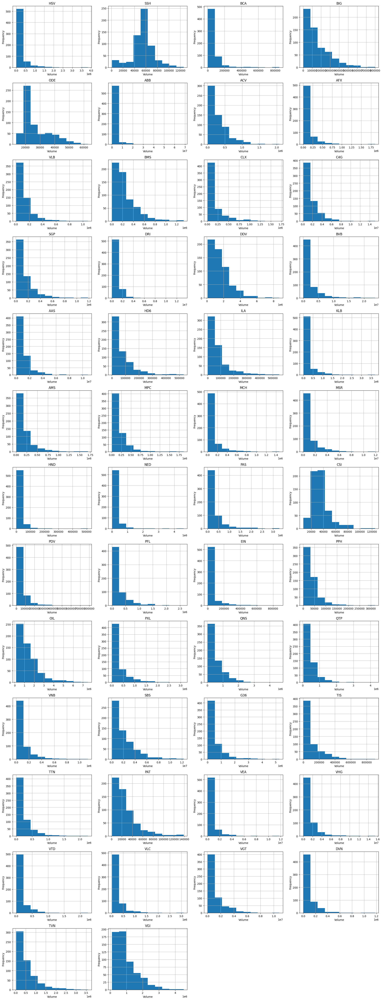

In [16]:
tickers = df_cleaned['ticker'].unique()
cols = 4  
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows)) 

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    ax = plt.subplot(rows, cols, i+1)
    ax.hist(df_temp['volume'])
    ax.set_title(t)
    ax.set_ylabel("Frequency")
    ax.set_xlabel('Volume')
    ax.grid(True)

plt.tight_layout()  
plt.show()

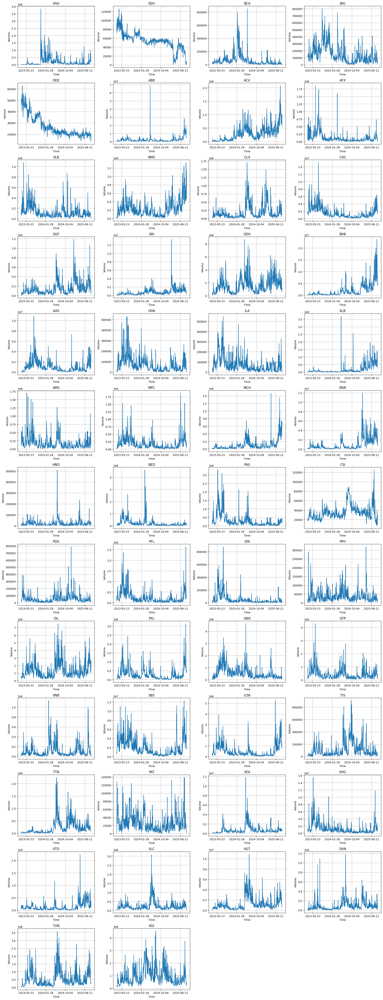

In [17]:
from matplotlib.ticker import MaxNLocator

tickers = df_cleaned['ticker'].unique()
cols = 4  
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows)) 

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    ax = plt.subplot(rows, cols, i+1)
    ax.plot(df_temp['timestamp'], df_temp['volume'])
    ax.set_title(t)
    ax.set_ylabel("Volume")
    ax.set_xlabel('Time')
    ax.xaxis.set_major_locator(MaxNLocator(nbins=4))
    ax.grid(True)

plt.tight_layout()  
plt.show()

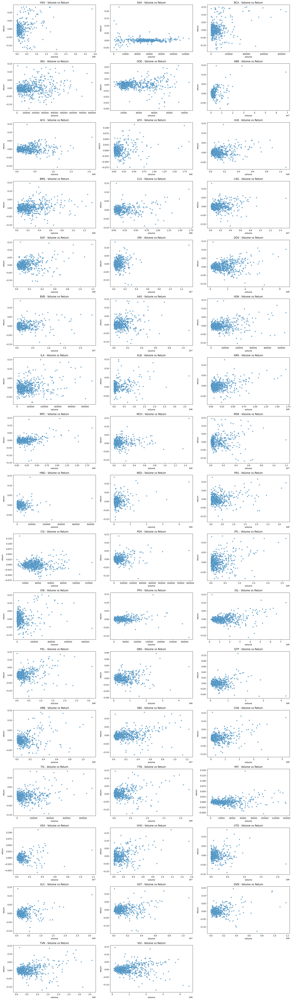

In [18]:
import seaborn as sns

tickers = df_cleaned['ticker'].unique()
cols = 3
rows = math.ceil(len(tickers)/cols)

plt.figure(figsize=(20, 4*rows))
for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker']==t]
    ax = plt.subplot(rows, cols, i+1)
    sns.scatterplot(x='volume', y='return', data=df_temp, ax=ax, alpha=0.6)
    ax.set_title(f"{t} - Volume vs Return")

plt.tight_layout()
plt.show()

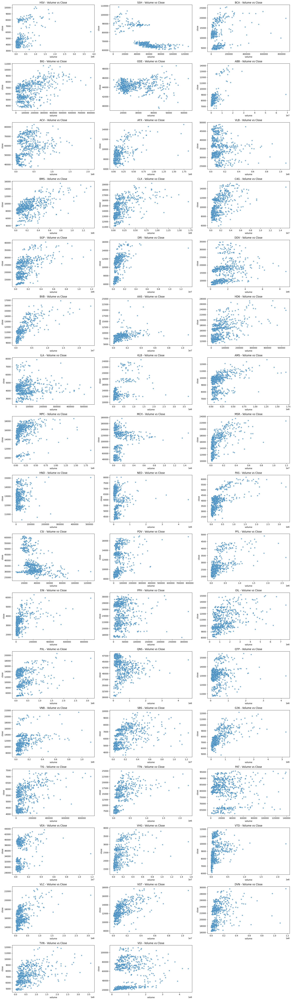

In [19]:
tickers = df_cleaned['ticker'].unique()
cols = 3
rows = math.ceil(len(tickers)/cols)

plt.figure(figsize=(20, 4*rows))
for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker']==t]
    ax = plt.subplot(rows, cols, i+1)
    sns.scatterplot(x='volume', y='close', data=df_temp, ax=ax, alpha=0.6)
    ax.set_title(f"{t} - Volume vs Close")

plt.tight_layout()
plt.show()

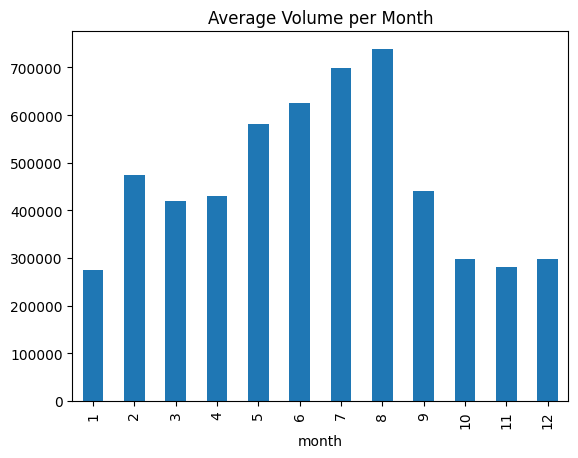

In [20]:
df_cleaned['month'] = df_cleaned['timestamp'].dt.month
monthly_avg = df_cleaned.groupby('month')['volume'].mean()
monthly_avg.plot(kind='bar')
plt.title("Average Volume per Month")
plt.show()

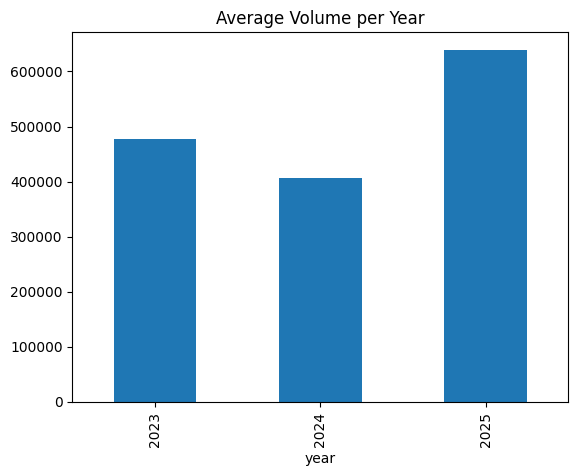

In [21]:
df_cleaned['year'] = df_cleaned['timestamp'].dt.year
monthly_avg = df_cleaned.groupby('year')['volume'].mean()
monthly_avg.plot(kind='bar')
plt.title("Average Volume per Year")
plt.show()

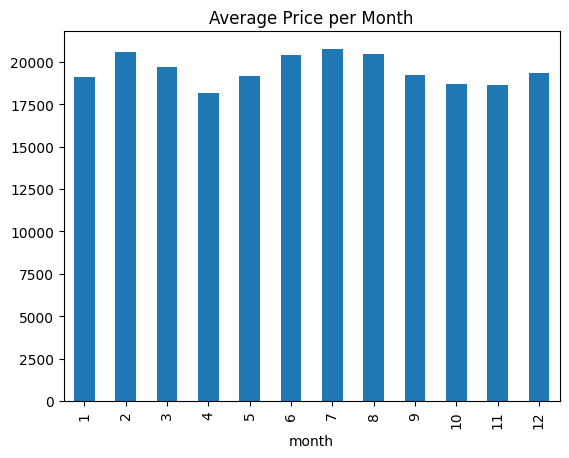

In [22]:
df_cleaned['month'] = df_cleaned['timestamp'].dt.month
monthly_avg = df_cleaned.groupby('month')['close'].mean()
monthly_avg.plot(kind='bar')
plt.title("Average Price per Month")
plt.show()

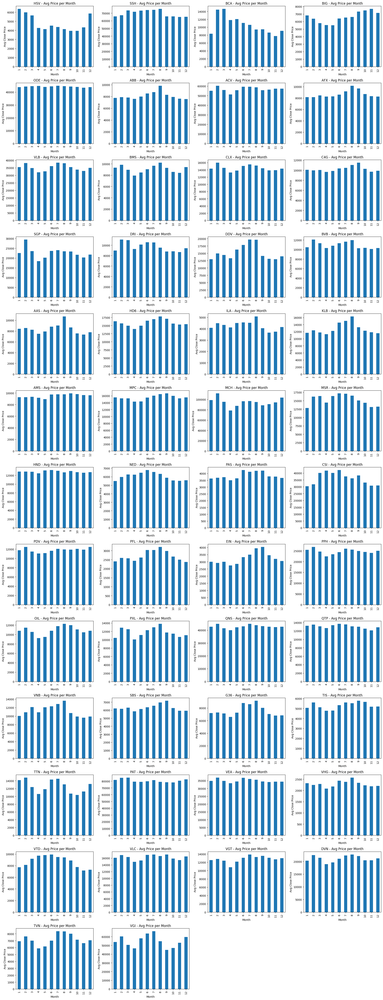

In [23]:
cols = 4
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows))

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    monthly_avg = df_temp.groupby('month')['close'].mean()

    ax = plt.subplot(rows, cols, i+1)
    monthly_avg.plot(kind='bar', ax=ax)
    ax.set_title(f"{t} - Avg Price per Month")
    ax.set_xlabel("Month")
    ax.set_ylabel("Avg Close Price")

plt.tight_layout()
plt.show()


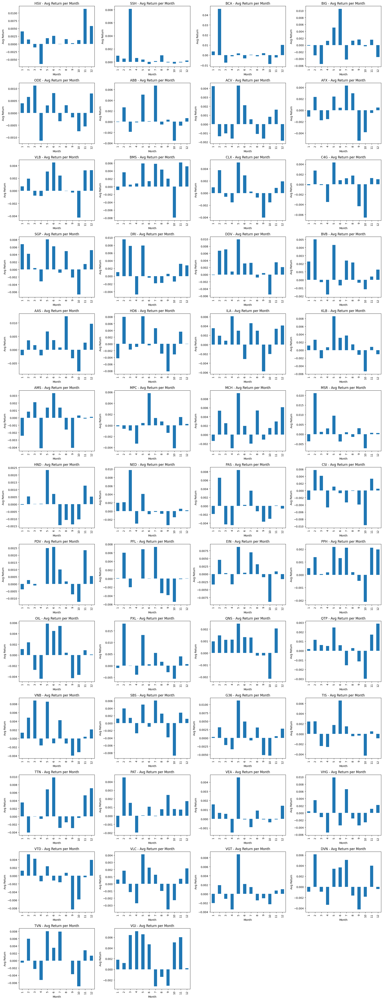

In [24]:
cols = 4
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows))

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    monthly_avg = df_temp.groupby('month')['return'].mean()

    ax = plt.subplot(rows, cols, i+1)
    monthly_avg.plot(kind='bar', ax=ax)
    ax.set_title(f"{t} - Avg Return per Month")
    ax.set_xlabel("Month")
    ax.set_ylabel("Avg Return")

plt.tight_layout()
plt.show()


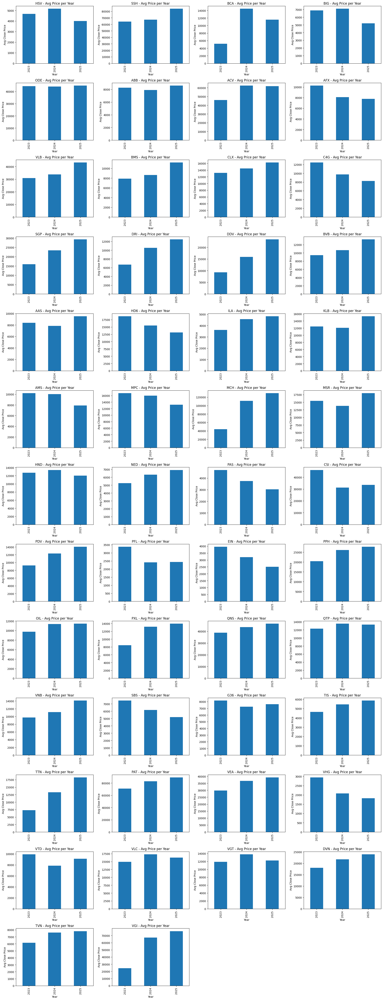

In [25]:
cols = 4
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows))

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    monthly_avg = df_temp.groupby('year')['close'].mean()

    ax = plt.subplot(rows, cols, i+1)
    monthly_avg.plot(kind='bar', ax=ax)
    ax.set_title(f"{t} - Avg Price per Year")
    ax.set_xlabel("Year")
    ax.set_ylabel("Avg Close Price")

plt.tight_layout()
plt.show()


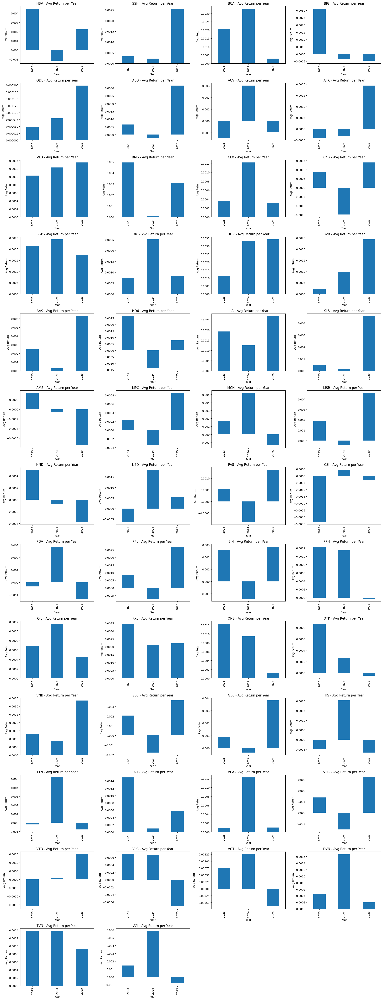

In [26]:
cols = 4
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows))

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    monthly_avg = df_temp.groupby('year')['return'].mean()

    ax = plt.subplot(rows, cols, i+1)
    monthly_avg.plot(kind='bar', ax=ax)
    ax.set_title(f"{t} - Avg Return per Year")
    ax.set_xlabel("Year")
    ax.set_ylabel("Avg Return")

plt.tight_layout()
plt.show()


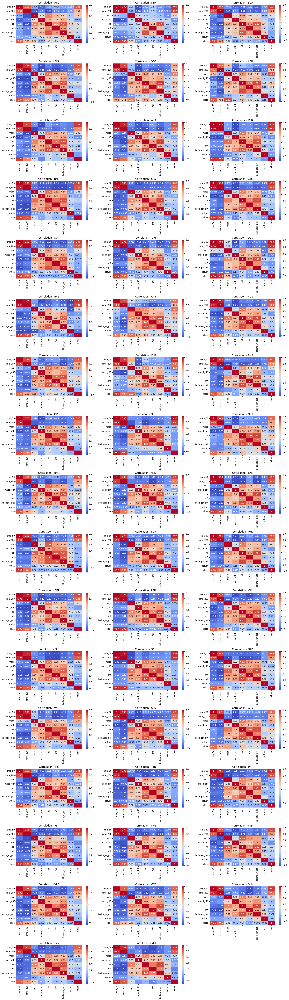

In [27]:
indicators = [
    'ema_50', 'ema_200', 'macd', 'macd_diff', 'rsi', 'mfi',
    'bollinger_pct', 'return', 'close'
]

cols = 3
rows = math.ceil(len(tickers)/cols)
plt.figure(figsize=(20, 4 * rows))

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    corr = df_temp[indicators].corr()
    
    ax = plt.subplot(rows, cols, i+1)
    sns.heatmap(corr, annot=True, cmap="coolwarm", ax=ax)
    ax.set_title(f"Correlation - {t}")
plt.tight_layout()
plt.show()

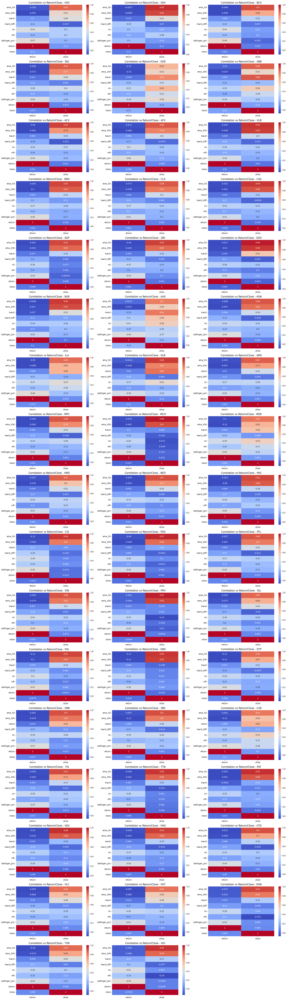

In [28]:
indicators = [
    'ema_50', 'ema_200', 'macd', 'macd_diff', 'rsi', 'mfi',
    'bollinger_pct'
]

cols = 3
rows = math.ceil(len(tickers) / cols)
plt.figure(figsize=(20, rows*4))

for i, t in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == t]
    
    corr = df_temp[indicators + ['return', 'close']].corr()
    target_corr = corr[['return', 'close']]  
    
    ax = plt.subplot(rows, cols, i+1)
    sns.heatmap(target_corr, annot=True, cmap="coolwarm", ax=ax)
    ax.set_title(f"Correlation vs Return/Close - {t}")

plt.tight_layout()
plt.show()

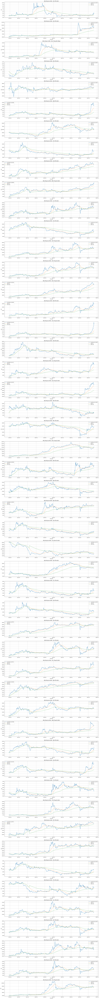

Phân loại xu hướng của các cổ phiếu:
HSV: Ổn định
SSH: Ổn định
BCA: Tăng biến động
BIG: Ổn định
ODE: Ổn định
ABB: Ổn định
ACV: Ổn định
AFX: Ổn định
VLB: Ổn định
BMS: Tăng ổn định
CLX: Ổn định
C4G: Ổn định
SGP: Tăng ổn định
DRI: Tăng ổn định
DDV: Tăng ổn định
BVB: Ổn định
AAS: Tăng ổn định
HD6: Ổn định
ILA: Tăng ổn định
KLB: Tăng ổn định
AMS: Ổn định
MPC: Ổn định
MCH: Tăng ổn định
MSR: Ổn định
HND: Ổn định
NED: Ổn định
PAS: Ổn định
CSI: Giảm ổn định
PDV: Ổn định
PFL: Ổn định
EIN: Ổn định
PPH: Ổn định
OIL: Ổn định
PXL: Tăng ổn định
QNS: Ổn định
QTP: Ổn định
VNB: Tăng ổn định
SBS: Ổn định
G36: Ổn định
TIS: Ổn định
TTN: Tăng ổn định
PAT: Ổn định
VEA: Ổn định
VHG: Ổn định
VTD: Ổn định
VLC: Ổn định
VGT: Ổn định
DVN: Ổn định
TVN: Ổn định
VGI: Tăng ổn định


In [29]:
import matplotlib.pyplot as plt
import numpy as np

# Hàm phân loại xu hướng dựa trên độ dốc của EMA 50 và độ biến động (ATR)
def classify_trend(df, ticker, window=14):
    df_ticker = df[df['ticker'] == ticker].copy()
    df_ticker['slope_ema50'] = df_ticker['ema_50'].diff() / df_ticker['ema_50'].shift(1)
    df_ticker['atr'] = df_ticker['high'] - df_ticker['low']  # Đơn giản hóa ATR
    mean_slope = df_ticker['slope_ema50'].mean()
    mean_atr = df_ticker['atr'].mean()
    
    if mean_slope > 0.001 and mean_atr < df_ticker['close'].mean() * 0.05:
        return 'Tăng ổn định'
    elif mean_slope > 0.001 and mean_atr >= df_ticker['close'].mean() * 0.05:
        return 'Tăng biến động'
    elif mean_slope < -0.001 and mean_atr < df_ticker['close'].mean() * 0.05:
        return 'Giảm ổn định'
    elif mean_slope < -0.001 and mean_atr >= df_ticker['close'].mean() * 0.05:
        return 'Giảm biến động'
    else:
        return 'Ổn định'

# Lấy danh sách các ticker
tickers = df_cleaned['ticker'].unique()

# Vẽ biểu đồ giá và phân loại xu hướng
plt.figure(figsize=(20, len(tickers) * 4))
for i, ticker in enumerate(tickers):
    df_temp = df_cleaned[df_cleaned['ticker'] == ticker]
    
    # Phân loại xu hướng
    trend = classify_trend(df_temp, ticker)
    
    # Vẽ biểu đồ giá
    ax = plt.subplot(len(tickers), 1, i+1)
    plt.plot(df_temp['timestamp'], df_temp['close'], label=f'Giá đóng cửa ({ticker})')
    plt.plot(df_temp['timestamp'], df_temp['ema_50'], label='EMA 50', linestyle='--')
    plt.plot(df_temp['timestamp'], df_temp['ema_200'], label='EMA 200', linestyle='--')
    plt.title(f'Biểu đồ giá và EMA - {ticker} ({trend})')
    plt.xlabel('Thời gian')
    plt.ylabel('Giá')
    plt.legend()
    plt.grid(True)

plt.tight_layout()
plt.show()

# In danh sách xu hướng
print("Phân loại xu hướng của các cổ phiếu:")
for ticker in tickers:
    trend = classify_trend(df_cleaned, ticker)
    print(f"{ticker}: {trend}")

In [30]:
# Phân tích Golden Cross và Death Cross
def analyze_crosses(df, ticker):
    df_ticker = df[df['ticker'] == ticker].copy()
    golden_crosses = df_ticker[df_ticker['golden_cross'] == 1][['timestamp', 'close']]
    death_crosses = df_ticker[df_ticker['death_cross'] == 1][['timestamp', 'close']]
    
    print(f"\nPhân tích Golden Cross và Death Cross cho {ticker}:")
    print(f"Số lần Golden Cross: {len(golden_crosses)}")
    if not golden_crosses.empty:
        print("Thời điểm Golden Cross:")
        print(golden_crosses)
    print(f"Số lần Death Cross: {len(death_crosses)}")
    if not death_crosses.empty:
        print("Thời điểm Death Cross:")
        print(death_crosses)

# Thống kê cho từng ticker
for ticker in tickers:
    analyze_crosses(df_cleaned, ticker)


Phân tích Golden Cross và Death Cross cho HSV:
Số lần Golden Cross: 2
Thời điểm Golden Cross:
     timestamp   close
149 2023-10-23  4396.0
607 2025-08-25  5069.0
Số lần Death Cross: 1
Thời điểm Death Cross:
     timestamp   close
280 2024-05-07  4475.0

Phân tích Golden Cross và Death Cross cho SSH:
Số lần Golden Cross: 2
Thời điểm Golden Cross:
      timestamp    close
838  2024-02-15  66671.0
1073 2025-01-20  67785.0
Số lần Death Cross: 2
Thời điểm Death Cross:
      timestamp    close
761  2023-10-23  63818.0
1064 2025-01-07  66802.0

Phân tích Golden Cross và Death Cross cho BCA:
Số lần Golden Cross: 2
Thời điểm Golden Cross:
      timestamp    close
1370 2023-10-23   5055.0
1712 2025-03-10  13577.0
Số lần Death Cross: 2
Thời điểm Death Cross:
      timestamp    close
1591 2024-09-12  12254.0
1731 2025-04-04  10378.0

Phân tích Golden Cross và Death Cross cho BIG:
Số lần Golden Cross: 4
Thời điểm Golden Cross:
      timestamp        close
1982 2023-10-23  8801.964830
2099 2024-04